# Advanced Lane Finding - Camera Calibration
##Student: Guido Graça

Importing the packages:

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
# Choose a Sobel kernel size
ksize = 7 # Choose a larger odd number to smooth gradient measurements

Adding a simplier version of Project 1 code. Used for lane lines detection for perspective transformation

In [2]:
###### Short version of the first project ######

yspace=0.58

def polygon(img,xspace_bottom=0.04,xspace_upper=0.46,yspace=0.58):
    """"This function creates a mask with the polygon representing the
    central area, in with one expect to find the lanes. Polygon vertices are
    found using relative spaces of the original image. Returns a grayscale image"""
    xsize,ysize=img.shape[1],img.shape[0]
    mask=np.zeros_like(img) #Creating the blank mask
    
    ## Setting the polygon vertices
    lower_left_vertice=(xsize*xspace_bottom,ysize)
    upper_left_vertice=(xsize*xspace_upper,ysize*yspace)
    upper_right_vertice=(xsize*(1-xspace_upper),ysize*yspace)
    lower_right_vertice=(xsize*(1-xspace_bottom),ysize)
    vertices = np.array([[lower_left_vertice,upper_left_vertice, upper_right_vertice, lower_right_vertice]], dtype=np.int32)
    
    # Creating the lines on the mask
    mask=cv2.fillPoly(mask,vertices,255)    
    return mask

def gauss_blur(img,kernel_size=5,gamma=1):
    """This image recieves a grayscale image and apply the Gaussian Blur"""
    return cv2.GaussianBlur(img,(kernel_size,kernel_size),gamma) 

def Canny(img,low=1,high=5):
    """Recieves a grayscale image and find the edges using the
    Canny algorithm. Low and high stand for the respectives low and high
    thresholds. It returns a grayscale image"""
    canny=cv2.Canny(img,low,high)
    return canny

def combine_img(img1,img2):
    """This function combines two images. Returns the combined image"""
    return cv2.bitwise_and(img1,img2)

def Hough(img,rho=1,theta=np.pi/180,threshold = 1,min_line_lenght = 5,max_line_gap = 15):
    """This funciton applies the Hough detection of lines in a grayscale image.
    Returns the m and b coeficients of the left and right line"""
    xsize=img.shape[1]
    lines=cv2.HoughLinesP(img,rho,theta,threshold,np.array([]),min_line_lenght,max_line_gap)  #Calculate the starting and ending  points of the lines
    
    #Creating lists for interpolate
    right,left=[[],[]],[[],[]] 
    for line in lines:
        for x1,y1,x2,y2 in line:
            m=(y2-y1)/(x2-x1)
            
            #Classify by position and slope
            if m>0 and (min(x1,x2)>xsize/2)and(abs(m)<5):
                right[0]+=[x1,x2]
                right[1]+=[y1,y2]        
            elif m<0 and (max(x1,x2)<xsize/2)and(abs(m)<5):
                left[0]+=[x1,x2]
                left[1]+=[y1,y2]          
   
    #Interpolate the points 
    m_right,b_right=np.polyfit(right[0],right[1],1)
    m_left,b_left=np.polyfit(left[0],left[1],1)
    return m_right,b_right,m_left,b_left

def draw_lines_perspective(img,m_right,b_right,m_left,b_left,yspace=0.64):
    """This funciton creates the
    Returns the m and b coeficients of the left and right line"""
    ysize=img.shape[0]
    
    #Calculating the four points of the lines
    PR1 =(int((ysize*yspace-b_right)/m_right),int(ysize*yspace))
    PR2=(int((ysize-b_right)/m_right),ysize)
    PL1=(int((ysize*yspace-b_left)/m_left),int(ysize*yspace))
    PL2=((int((ysize-b_left)/m_left),ysize))
    
    list_points=[PL2,PL1,PR1,PR2]

    return list_points

def lines_identifier_gray_lists(image):  
    """this functions combines all the previous functions.
    Recieves an image and returs the same images but with the lines 
    highlighted"""

    blur_gray=gauss_blur(image)   #Applying the blur
    edges=Canny(blur_gray)     #Applying Canny
    
    ## Polygon
    mask=polygon(edges)     #Create mask with polygon
    masked_edges=combine_img(edges,mask)   #Applying Polygon

    ## Hough algorithm
    m_right,b_right,m_left,b_left=Hough(masked_edges)   #Applying Hough  
    list_points=draw_lines_perspective(masked_edges,m_right,b_right,m_left,b_left)
    return list_points,m_left,m_right

#########################################

Defining the Camera Calibration and distortion correction functions

In [3]:
##### Camera Calibration and distortion correction #####

def calibrateCamera(dir="camera_cal/calibration*.jpg"):
    """This function finds the camera calibration parameters.
    By default, it uses the path  camera_cal/ and the images
    are named like calibration*.jpg"""
    
    #Initializing variables
    nx,ny=9,6 #chessboard dimensions
    objpoints,imgpoints=[],[] #initializing the lists
    objp=np.zeros((nx*ny,3),dtype=np.float32)
    objp[:,0:2]=np.mgrid[0:nx,0:ny].T.reshape(-1,2)
    
    # Importing all the images as a list of paths
    images=glob.glob(dir)
        
    #loop for opening and finding chessboard corners for each image
    for path in images: 
        img=cv2.imread(path)#Read image
        gray=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)#Color conversion
        ret,corners=cv2.findChessboardCorners(gray,(nx,ny))#Find corners
        if ret==True: 
            #Append the results to the lists
            objpoints.append(objp)
            imgpoints.append(corners)

    #Calculate the camera undistortion parameters
    ret,mtx,dist,rvecs,tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
    print ("Calibrated camera")
    return mtx,dist

def undistort(image,mtx,dist):
    """This function recieves an image and the matrix and distortion parameters. It returns the undistorced image"""
    dst=cv2.undistort(image,mtx,dist,None,mtx)
    return dst

#############################

Defining the thresholding functions, using HLS Colorspace and Sobel Gradient technique


In [4]:
### Thresholding functions ###

def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    """Thresholding using Sobel x or y"""
    
    # Calculate directional gradient
    gray=cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    if orient=="x": sobel=cv2.Sobel(gray,cv2.CV_64F,1,0,ksize=sobel_kernel)
    elif orient=="y": sobel=cv2.Sobel(gray,cv2.CV_64F,0,1,ksize=sobel_kernel)
    
    
    sobel=np.absolute(sobel) #Get the absolute value
    sobel=np.uint8(255*sobel/np.max(sobel)) #Ajust for 0-255 range int type
    
    # Apply threshold
    grad_binary=np.zeros_like(gray)
    grad_binary[(sobel>=thresh[0])&(sobel<=thresh[1])]=1
    return grad_binary

def hls_thresh(img,s_thresh=(0,255),h_thresh=(0,255)):
    """Thresholding using HLS's H and S Color channels"""
    
    #Color conversion
    hls=cv2.cvtColor(img,cv2.COLOR_RGB2HLS)
    
    #H Channel Thresholding
    h_channel=hls[:,:,0]
    h_channel2=np.uint8(255*(h_channel/h_channel.max()))
    binary_h=np.zeros_like(h_channel2)
    binary_h[(h_channel2>h_thresh[0])&(h_channel<=h_thresh[1])]=1    
    
    #S Channel Thresholding
    s_channel=hls[:,:,2]
    s_channel2=np.uint8(255*(s_channel/s_channel.max()))
    binary_s=np.zeros_like(s_channel2)
    binary_s[(s_channel2>s_thresh[0])&(s_channel<=s_thresh[1])]=1
    
    #Combining thresholded images
    binary=np.zeros_like(binary_h)
    binary[(binary_h==1)&(binary_s==1)]=1    
    return binary


def combine_binary(img1,img2):
    """Adds 2 binary images"""
    combine=np.zeros_like(img1)
    combine[(img1==1)|(img2==1)]=1
    return combine

#############################

Defining the Masking and Perspecitve Transformation functions

In [5]:
### Masking and Perspecitve Transformation functions ###

def polygon_masking(img,points,margin=10):
    """"This function creates a mask with the polygon representing the
    central area, but using the lane lines found in lane detection algorimth. 
    Polygon vertices are found using offsets of the lane lines. Returns a 
    grayscale image"""
    
    mask=np.zeros_like(img) #Creating the blank mask
    
    ## Ajusting between np array and list variable
    points_list=[]
    for i in range(len(points)):
        points_list.append(list(points[i]))
    
    ## Add the margin offset
    points_list[0][0]-=margin
    points_list[1][0]-=margin
    points_list[2][0]+=margin
    points_list[3][0]+=margin
    
    ## Setting the polygon vertices as variables
    lower_left_vertice=points_list[0]
    upper_left_vertice=points_list[1]
    upper_right_vertice=points_list[2]
    lower_right_vertice=points_list[3]
    vertices = np.array([[lower_left_vertice,upper_left_vertice, upper_right_vertice, lower_right_vertice]], dtype=np.int32)
    
    ## Creating the lines on the mask
    mask=cv2.fillPoly(mask,vertices,255)   
    output=cv2.bitwise_and(img,mask)
    return output
  
def perspective_Matrixes(img,points):
    """"This function calculates the Matrixes of perspective transformation
    and its inverse"""
    
    ## Defining variables
    xsize,ysize=img.shape[1],img.shape[0]
    points_list=[]
    
    ## Ajusting between np array and list variable
    for i in range(len(points)):
        points_list.append(list(points[i]))
        
    ## Setting the input
    src =np.float32(points_list)
 
    ##Setting the output
    o1=[0.25*xsize,ysize]
    o2=[0.25*xsize,0]
    o3=[0.75*xsize,0]
    o4=[0.75*xsize,ysize]
    output=[o1,o2,o3,o4]
    dst=np.float32(output)
    
    #Get Perspective Matrix and its inverse 
    M=cv2.getPerspectiveTransform(src,dst)
    M_inv=cv2.getPerspectiveTransform(dst,src)
    return M,M_inv

def perspective(img,M):
    """This function applies the perspective transformation
    on an image """
    xsize,ysize=img.shape[1],img.shape[0]
    dst=cv2.warpPerspective(img,M,(xsize,ysize))
    return dst

def get_Matrixes(frame):
    
    ## Before loop, finding the Matrices:
    frame_inicial=cv2.cvtColor(frame,cv2.COLOR_BGR2RGB)
    gradx_lines = abs_sobel_thresh(frame_inicial, orient='x', sobel_kernel=ksize, thresh=(60, 100)) #Used for finding lane lines
    hls_threshed=hls_thresh(frame_inicial,s_thresh=(170, 255),h_thresh=(20, 100))
    final_lines=combine_binary(gradx_lines,hls_threshed)#Used for finding lane lines
    # final_lines=hls_thresh2(frame,final_lines)
    
    
    ## Finding the lane lines for perspective transformation
    list_points,a,b=lines_identifier_gray_lists(final_lines)
    
    #Get transformation Matrixes 
    M,M_inv=perspective_Matrixes(frame_inicial,list_points)
    return M,M_inv


#############################

Defining Histogram and interpolation functions

In [6]:
### Histogram and interpolation functions ###

def histogram(gray):
    """This function calculates the left and right lines coefficients based on
    a polyfit on the nonzero pixels using the sliding windows technique"""
    
    ### Defining parameters ###
    ysize=gray.shape[0]
    num_windows=9
    margin = 80
    minpix=50
    win_size=ysize//num_windows

    
    ## Finding non zero pixels    
    nonzero=gray.nonzero()
    nonzeroy=np.array(nonzero[0])
    nonzerox=np.array(nonzero[1])
    
    ## Finding starting points for the lines thresholding
    histogram=np.sum(gray[gray.shape[0]//2:,:],axis=0)
    midpoint=gray.shape[1]//2
    max_left=np.argmax(histogram[:midpoint])
    max_right=np.argmax(histogram[midpoint:])+midpoint

    ## Initializing lists of indices of lane pixels
    left_lanes_ind=[]
    right_lanes_ind=[]
    
    #Convert from pixels to meters parameters
    pixel2meter_x=3.7/(max_right-max_left)
    pixel2meter_y=30/ysize
    
    
    ##  Loop for each windows ##
    for i in range(num_windows):
        
        ## Defing the box edges:
        y_win_high=ysize-i*win_size
        y_win_low=y_win_high-win_size
        left_x_win_low=max_left-margin
        left_x_win_high=max_left+margin
        right_x_win_low=max_right-margin
        right_x_win_high=max_right+margin
        
        #Find lines pixels within windows (and storing their indices)
        left_lanes= ((nonzeroy<y_win_high)&(nonzeroy>y_win_low)&(nonzerox>left_x_win_low)&(nonzerox<left_x_win_high)).nonzero()[0]
        right_lanes= ((nonzeroy<y_win_high)&(nonzeroy>y_win_low)&(nonzerox>right_x_win_low)&(nonzerox<right_x_win_high)).nonzero()[0]
        
        #Add pixels to list
        left_lanes_ind.append(left_lanes)
        right_lanes_ind.append(right_lanes)
        
        #Reavaliate center of windows
        if left_lanes.size>minpix:
            histogram_left=np.sum(gray[y_win_low : y_win_high , left_x_win_low : left_x_win_high],axis=0)
            center=np.argmax(histogram_left)
            max_left+=(center-margin)
            
        if right_lanes.size>minpix:
            histogram_right=np.sum(gray[y_win_low : y_win_high , right_x_win_low : right_x_win_high],axis=0)
            center=np.argmax(histogram_right)
            max_right+=(center-margin)
     
    
    ## Concatenating lists
    left_lanes_ind=np.concatenate(left_lanes_ind)     
    right_lanes_ind=np.concatenate(right_lanes_ind)
    
    ## Finding x and y positions of the Left and Right lanes
    leftx=nonzerox[left_lanes_ind]
    lefty=nonzeroy[left_lanes_ind]
    rightx=nonzerox[right_lanes_ind]
    righty=nonzeroy[right_lanes_ind]        
    
    ## Calculate the interpolation coefficients in Pixel space (for exporting)
    left_interpol=np.polyfit(lefty,leftx,2)
    right_interpol=np.polyfit(righty,rightx,2)
    
    
     ## Calculate the interpolation coefficients in Pixel space
    leftx_m,rightx_m=leftx*pixel2meter_x,rightx*pixel2meter_x
    lefty_m,righty_m=lefty*pixel2meter_y,righty*pixel2meter_y
    left_interpol_m=np.polyfit(lefty_m,leftx_m,2)
    right_interpol_m=np.polyfit(righty_m,rightx_m,2)
    
    ## Calculate the radius of curvature
    y_eval=ysize*pixel2meter_y
    left_radius=(1+(2*y_eval*left_interpol_m[0]+left_interpol_m[1])**2)/(left_interpol_m[0])
    right_radius=(1+(2*y_eval*right_interpol_m[0]+right_interpol_m[1])**2)/(right_interpol_m[0])
    
    return left_radius, right_radius,left_interpol, right_interpol
    
def interpol(gray,left_interpol,right_interpol):
    """This function recieves an image and two lists with the polyfit indices.
    It colores the lane line pixels and the lane"""
    
    ## Definitions
    xsize,ysize=gray.shape[1],gray.shape[0]
    margin=50
    
    ## Setting the output
    out_img=np.zeros_like(np.stack((gray,gray,gray),-1))
    out_img2=np.copy(out_img)
    
    ## Finding non zeros pixels
    nonzero=gray.nonzero()
    nonzeroy=nonzero[0] # List of the x coordenate of the image non 0 pixel
    nonzerox=nonzero[1] # List of the y coordenate of the image non 0 pixel
    
    ## Calculate lines line with interpolation coefficients
    left_line=left_interpol[0]*nonzeroy**2+left_interpol[1]*nonzeroy+left_interpol[2]
    right_line=right_interpol[0]*nonzeroy**2+right_interpol[1]*nonzeroy+right_interpol[2]
    
    ## Identify lane pixels
    left_lane_ind= ((nonzerox<left_line+margin)&(nonzerox>left_line-margin)).nonzero()[0]
    right_lane_ind= ((nonzerox<right_line+margin)&(nonzerox>right_line-margin)).nonzero()[0]
    
    ## Calculate x and y positions of the lane pixels
    leftx=nonzerox[left_lane_ind]
    lefty=nonzeroy[left_lane_ind]
    rightx=nonzerox[right_lane_ind]
    righty=nonzeroy[right_lane_ind]

    ## Coloring lane pixels
    out_img[lefty,leftx]=[0,0,255]
    out_img[righty,rightx]=[255,0,0]
    
    ## Calculate the lane lines
    ploty=np.linspace(0,ysize-1,ysize)
    left_plot=left_interpol[0]*ploty**2+left_interpol[1]*ploty+left_interpol[2]
    right_plot=right_interpol[0]*ploty**2+right_interpol[1]*ploty+right_interpol[2]
    
    ## Plotting the green lane
    left_line_window1 = np.array([np.transpose(np.vstack([left_plot, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_plot,ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    cv2.fillPoly(out_img2, np.int_([left_line_pts]), (0,255, 0))

    ## Coefficients to units convertion (Pixels to meters)
    p2m_x=(3.7/(right_plot[-1]-left_plot[-1]))
    p2m_y=(10/ysize)
    
    ##Calculate the polyline coefficients im meters:

    left_interpol_m=[(p2m_x/(p2m_y**2))*left_interpol[0],(p2m_x/(p2m_y))*left_interpol[1]]
    right_interpol_m=[(p2m_x/(p2m_y**2))*right_interpol[0],(p2m_x/(p2m_y))*right_interpol[1]]
    
    ##Calculate the radius im meters:
    y_eval=ploty[-1]*p2m_y 
    left_radius=(1+(2*y_eval*left_interpol_m[0]+left_interpol_m[1])**2)/(left_interpol_m[0])
    right_radius=(1+(2*y_eval*right_interpol_m[0]+right_interpol_m[1])**2)/(right_interpol_m[0])
    radius=np.array([left_radius,right_radius])

    
    
    ## Generate the output image
    result = cv2.addWeighted(out_img, 1, out_img2, 0.3, 0)
    # cv2.circle(result,(int(center),ysize),5,(255,255,0),20)

    # plt.imsave('etaporra.jpg',result)
    return result,radius

###################################

Defining Main functions on image and on video

In [7]:
### Main functions on image and on video ###

def main_function_image(frame):

    """This is the last function. It recieves a file directory and applies
    he lines_identifier frame by frame. Saves a video file. Returns None"""
    
    # Calibrating the camera distortion
    xsize,ysize=frame.shape[1],frame.shape[0]
    mtx,dist=calibrateCamera()
    frame=undistort(frame,mtx,dist)
    frame_original=np.copy(frame) #Used for last combination

    #Get the perspecitve transformation Matrixes 
    M,M_inv=get_Matrixes(frame)           
       
    ## Threshold image using Sobel x and HLS color space
    gradx = abs_sobel_thresh(frame, orient='x', sobel_kernel=ksize, thresh=(60, 100))
    hls_threshed=hls_thresh(frame,s_thresh=(170, 255),h_thresh=(20, 100))
    final=combine_binary(gradx,hls_threshed)
    
    ## Finding the lane lines for perspective transformation
    list_points,m_left,m_right=lines_identifier_gray_lists(final)
    masked=polygon_masking(final,list_points)

    # Perspective transform binary on segmented frame
    perspective_masked=perspective(masked,M)

    # Calculate the Radius of curvature and the first interpolation coefficients
    left_radius, right_radius,left_interpol, right_interpol=histogram(perspective_masked)

    #Calculate new interpolation coeficientes and returns the binary 
    masked_perspective,radius,=interpol(perspective_masked, left_interpol, right_interpol)
    radius_mean=int((radius[0]+radius[1])/2)

    ## Avaliate the Radius of curvature direction
    if radius_mean>0:
        text= "Right curve with radius "+str(int(radius_mean))+"(m)"
    else:
       text= "Left curve with radius "+str(int(-radius_mean))+"(m)" 
       
  
    ##Calculates and plots the final image
    lines_frame=perspective(masked_perspective, M_inv)
    last_line=lines_frame[-1,:]
    first,last=last_line.nonzero()[0][0],last_line.nonzero()[0][-1]

    lane_center=(first+last)/2
    p2m_x=3.7/(last-first)
    
    offset=(xsize/2-lane_center)*p2m_x
    
    # Avaliate the curve direction
    if offset>0:
        text2="The car center is "+str(round(abs(100*offset),1))+" (cm) to the right"
    else:
        text2="The car center is "+str(round(abs(100*offset),1))+" (cm) to the left"
    
    final=cv2.addWeighted(frame_original,1,lines_frame,1.3,0)
    
    #Adding text to the frame
    final=cv2.putText(final,text, (100,100), cv2.FONT_HERSHEY_SIMPLEX,1, (255,255,255), 2, cv2.LINE_AA) 
    final=cv2.putText(final,text2, (100,150), cv2.FONT_HERSHEY_SIMPLEX,1, (255,255,255), 2, cv2.LINE_AA) 

    cv2.circle(final,(int(lane_center),ysize),5,(255,255,255),10)
    cv2.circle(final,(int(xsize/2),ysize),5,(0,0,0),10)


    
    return final
    
def lines_on_video(file_name,file_type):
    """This is the last function. It recieves a file directory and applies
    he lines_identifier frame by frame. Saves a video file. Returns None"""
    
    # Opening the video
    cap = cv2.VideoCapture(file_name+file_type)
    ret, frame = cap.read()
    
    # Calibrating the camera distortion
    mtx,dist=calibrateCamera()
    frame=undistort(frame,mtx,dist)
    
    # Setting up the output video
    xsize,ysize=frame.shape[1],frame.shape[0]
    fourcc = cv2.VideoWriter_fourcc(*'DIVX')
    out = cv2.VideoWriter("test_video_output/"+file_name+'_final.mp4',fourcc, 20.0, (xsize,ysize))
 
    #Get transformation Matrixes 
    M,M_inv=get_Matrixes(frame)
    
    # Initializing parameters for error estimate
    left_interpol_list,right_interpol_list=[],[]
    left_error=right_error=radius_error=0
    radius_old=0
    i=0
    
    
    # # Used for skipping frames. Uncomment if desired
    # skipped_frame=570
    # while(i<skipped_frame): 
    #     ret, frame = cap.read() #Refresh the frame
    #     i+=1

    # Initaliting new counter variable
    frame_counter=0
    
    while(True):
        
        # Add the counters
        i+=1
        frame_counter+=1
        if i%50==0: print ("frame ",i) #For monitoring. Uncomment if desired
        
        
        ret, frame = cap.read() #Refresh the frame
        if (frame is None):
            break 
        
        # Correct camera distortion
        frame=undistort(frame,mtx,dist)              
        frame_original=np.copy(frame) #Used for last combination
        frame=cv2.cvtColor(frame,cv2.COLOR_BGR2RGB) #Adjusting color space   
        
        ## Threshold image using Sobel X and HLS Color space
        gradx = abs_sobel_thresh(frame, orient='x', sobel_kernel=ksize, thresh=(50, 100))
        hls_threshed=hls_thresh(frame,s_thresh=(170, 255),h_thresh=(20, 100))
        final=combine_binary(gradx,hls_threshed)
        final=cv2.dilate(final,np.ones((3,3)))
      
        ## Finding the lane lines for perspective transformation
        list_points,m_left,m_right=lines_identifier_gray_lists(final)
        masked=polygon_masking(final,list_points)

        # Transform binary on segmented frame
        perspective_masked=perspective(masked,M)
        
        # Calculate the Radius of curvature and the first interpolation coefficients
        left_radius, right_radius,left_interpol, right_interpol=histogram(perspective_masked)
        
        
        ##Avaliate interpol curvature 
        if frame_counter<5: #First five frames
            left_interpol_list.append(left_interpol.tolist())
            right_interpol_list.append(right_interpol.tolist())
        else: 
            #Verify the "a" coefficient of the left lane line
            a_left=left_interpol_list[-1][0]
            var_left=abs((a_left-left_interpol.tolist()[0])/a_left)            
            if (var_left<2) or (left_error==6):
               left_interpol_list.append(left_interpol.tolist())
               left_error=0
            else:
                left_interpol=np.array(left_interpol_list[-1])
                # print("bad left line")
                left_error+=1
                
            #Verify the "a" coefficient of the right lane line    
            a_right=right_interpol_list[-1][0]
            var_right=abs((a_right-right_interpol.tolist()[0])/a_right)                     
            if (var_right<2) or (right_error==6):
               right_interpol_list.append(right_interpol.tolist())
               right_error=0
            else:
                right_interpol=np.array(right_interpol_list[-1])
                # print("bad right line")
                right_error+=1 
                
        #Calculate the radius of curvature and the masked perspective with lane in green
        masked_perspective,radius,=interpol(perspective_masked, left_interpol, right_interpol)
        
        lines_frame=perspective(masked_perspective, M_inv)
        last_line=lines_frame[-1,:]
        first,last=last_line.nonzero()[0][0],last_line.nonzero()[0][-1]

        lane_center=(first+last)/2
        p2m_x=3.7/(last-first)
        
        offset=(xsize/2-lane_center)*p2m_x
        
        # Avaliate the curve direction
        if offset>0:
            text2="The car center is "+str(round(abs(100*offset),1))+" (cm) to the right"
        else:
            text2="The car center is "+str(round(abs(100*offset),1))+" (cm) to the left"
            
            
        radius_mean=int((radius[0]+radius[1])/2)
        
        ## Compare the new and old value of radius 
        if (frame_counter==1 or((abs((radius_mean-radius_old)/radius_old))<2) or (radius_error==3)) and (radius_mean!=0) :
            radius_old=radius_mean
        elif (abs((radius_mean-radius_old)/radius_old))>2 :
            radius_mean=radius_old
            radius_error+=1
        
        ## Avaliate the curve direction
        if radius_mean>0:
            text_temp= "Right curve with radius "+str(int(radius_mean))+"(m)"
        else:
           text_temp= "Left curve with radius "+str(int(-radius_mean))+"(m)" 
        
        ## Avaliate the curve direction
        if offset>0:
            text_temp2="The car center is "+str(round(abs(100*offset),1))+" (cm) to the right"
        else:
            text_temp2="The car center is "+str(round(abs(100*offset),1))+" (cm) to the left"
        
        
        ## Change the Text at each two frames
        if (frame_counter==1) or (frame_counter%2==0):text,text2 = text_temp,text_temp2
        
        ## Calculates and plots the final image
        final=cv2.addWeighted(frame_original,1,lines_frame,1.3,0)
        
        #Adding text to the frame
        final=cv2.putText(final,text, (100,100), cv2.FONT_HERSHEY_SIMPLEX,1, (255,255,255), 2, cv2.LINE_AA) 
        final=cv2.putText(final,text2, (100,150), cv2.FONT_HERSHEY_SIMPLEX,1, (255,255,255), 2, cv2.LINE_AA) 
        cv2.circle(final,(int(lane_center),ysize),5,(255,255,255),10)
        cv2.circle(final,(int(xsize/2),ysize),5,(0,0,0),10)
        out.write(final)

    cap.release()
    out.release()
    print("end")
    return None


Now, for testing and save each undistorted image: 

Calibrated camera


/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


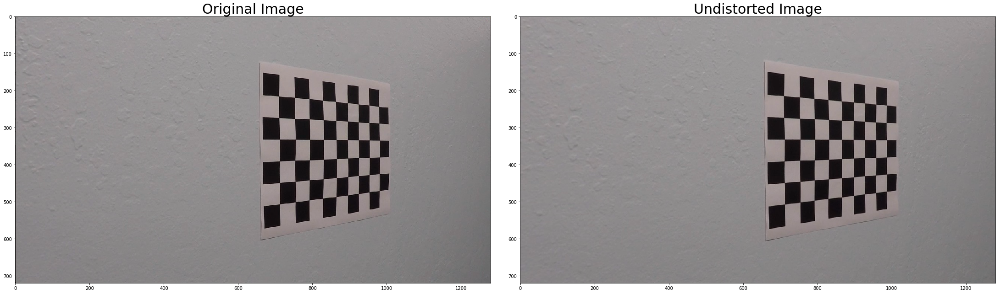

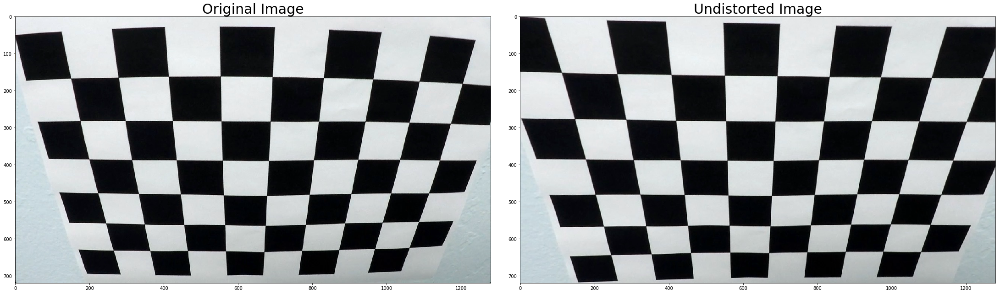

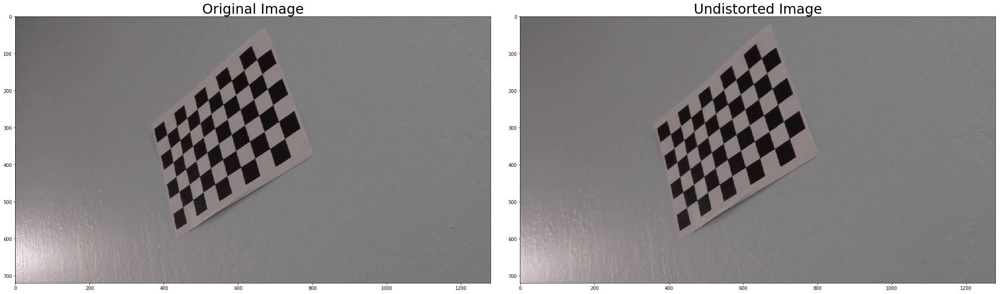

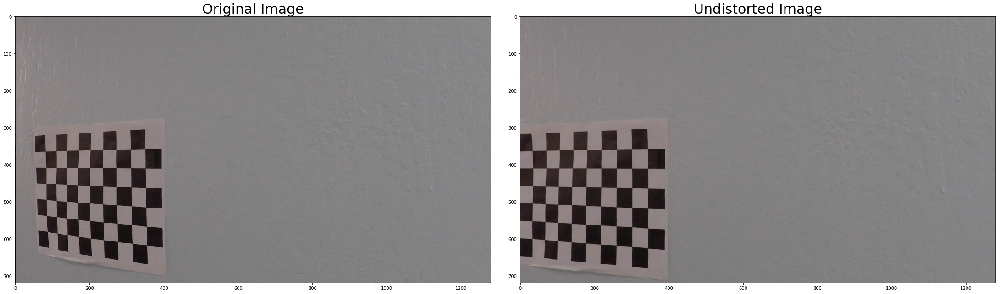

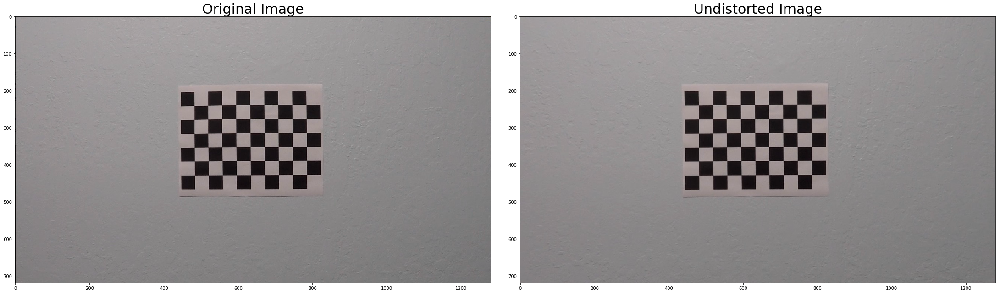

...

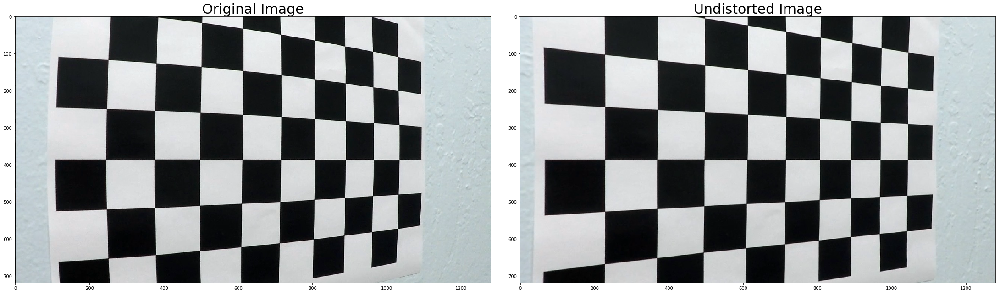

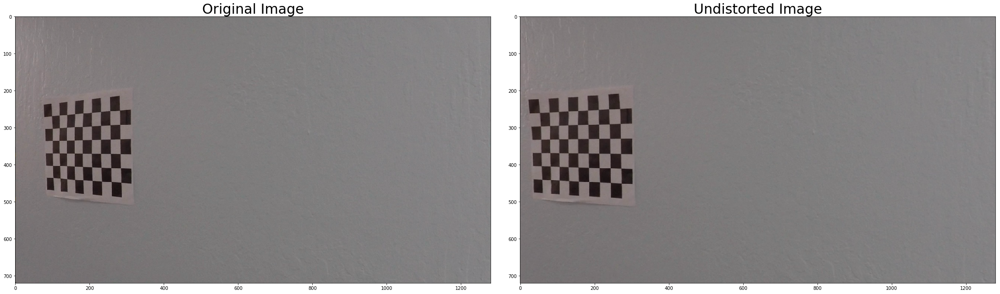

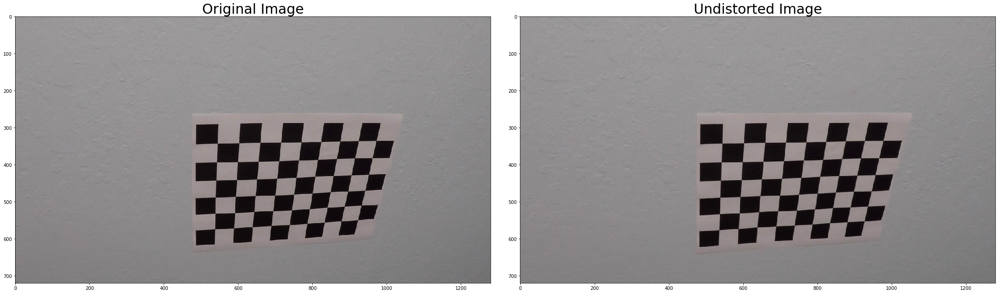

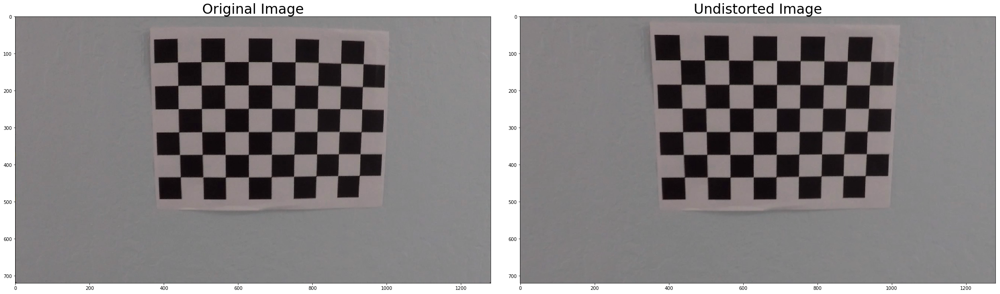

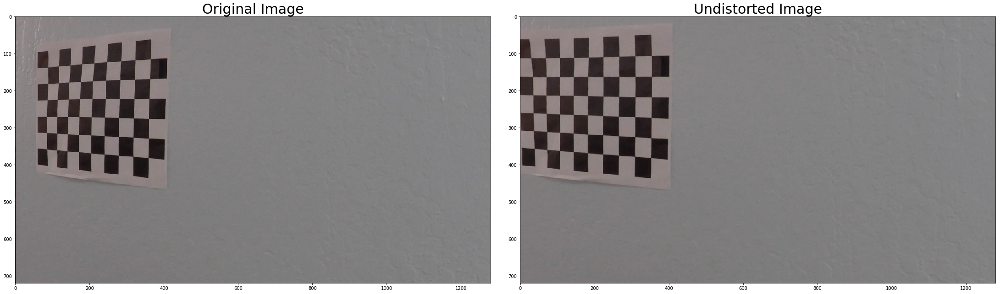

In [8]:
mtx,dist=calibrateCamera()
dir="camera_cal/calibration*.jpg"
images=glob.glob(dir)
count=0 #For ajusting file name
#loop for opening and finding chessboard corners for each image
for path in images: 
    img=cv2.imread(path)#Read image
    count+=1
    undistor=undistort(img,mtx,dist)
    f, (ax1, ax2) = plt.subplots(1,2, figsize=(30, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(undistor)
    ax2.set_title('Undistorted Image', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.figure()
    plt.imsave("calibration_output/Calibrated "+str(count)+".jpg",undistor)

Testing the main function on the test images

Calibrated camera


/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:48: RuntimeWarning: divide by zero encountered in int_scalars


Calibrated camera
Calibrated camera
Calibrated camera
Calibrated camera
Calibrated camera
Calibrated camera
Calibrated camera


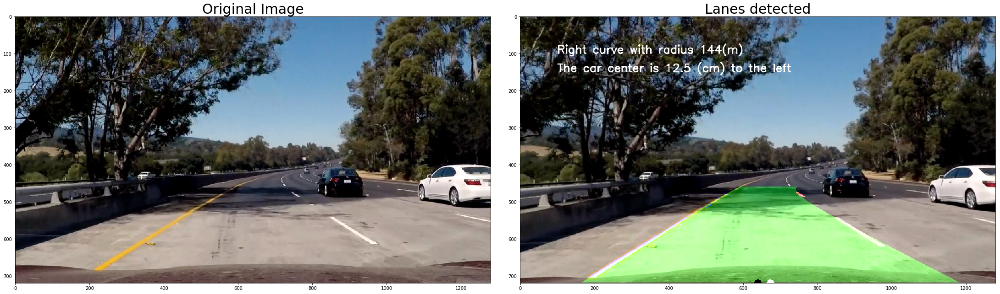

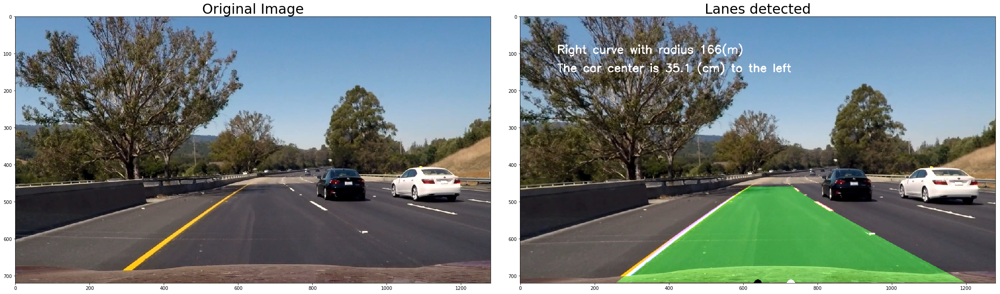

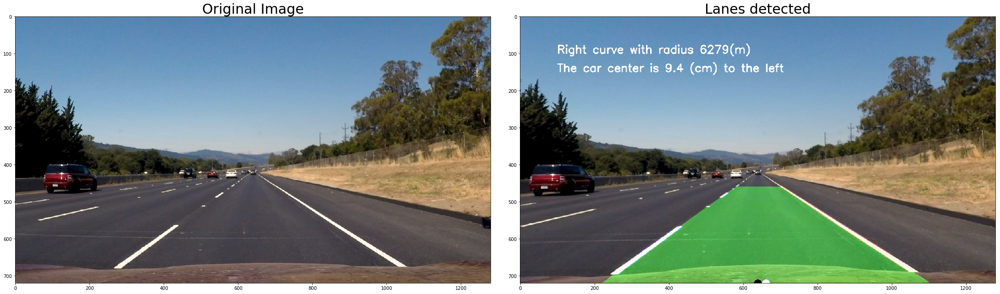

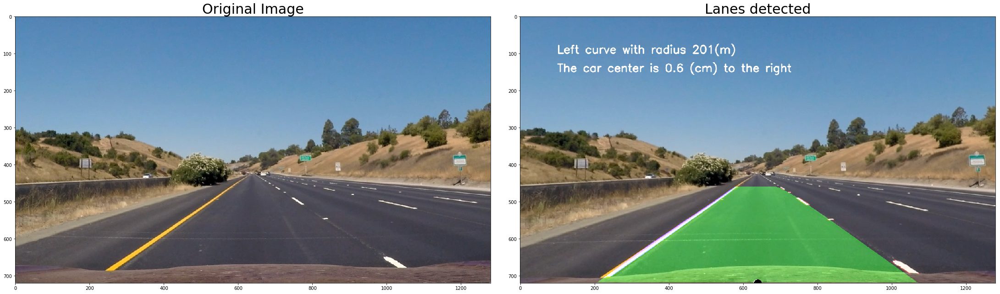

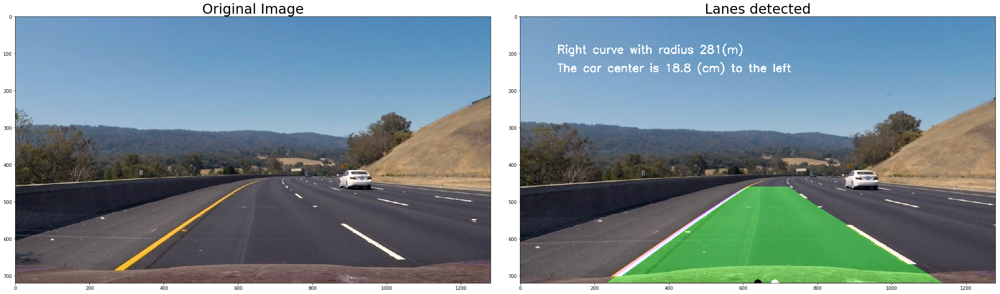

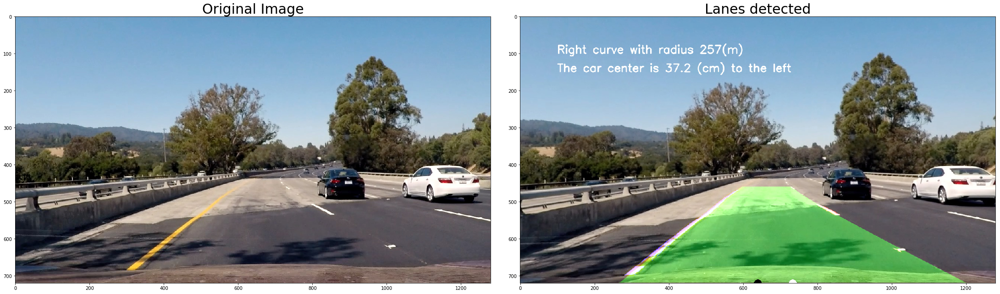

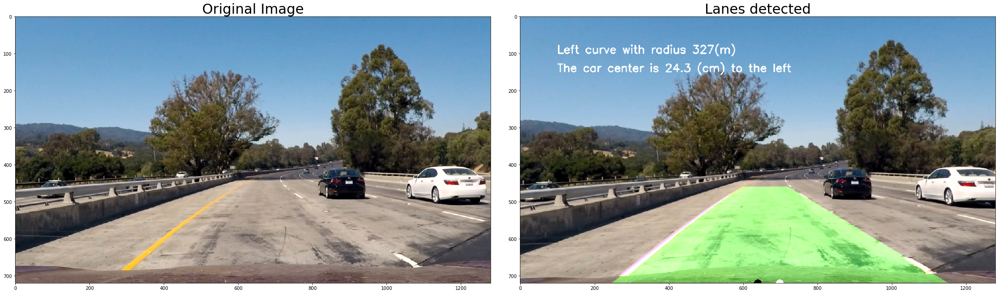

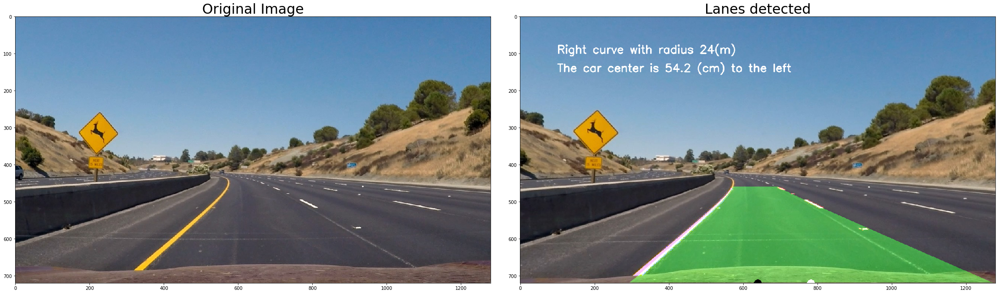

In [9]:
images=glob.glob("test_images/*.jpg")
i=0
for path in images:
    i+=1
    img=plt.imread(path)
    out=main_function_image(img)
    plt.imsave("output_images/Output "+str(i)+'.jpg',out)
    f, (ax1, ax2) = plt.subplots(1,2, figsize=(30, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(out)
    ax2.set_title('Lanes detected', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.figure()

At last, run code on project video

In [10]:
file_name,file_type="project_video",".mp4"
lines_on_video(file_name,file_type)

Calibrated camera


/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:48: RuntimeWarning: divide by zero encountered in int_scalars


frame  50
frame  100
frame  150
frame  200
frame  250
frame  300
frame  350
frame  400
frame  450
frame  500
frame  550
frame  600
frame  650


/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:78: RankWarning: Polyfit may be poorly conditioned
/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:85: RankWarning: Polyfit may be poorly conditioned


frame  700
frame  750
frame  800
frame  850
frame  900
frame  950
frame  1000
frame  1050
frame  1100
frame  1150
frame  1200
frame  1250
end
